In [2]:
import pandas as pd
import numpy as np


# Ordenamiento y limpieza de datos

### Cargar y modelar datos generales

In [3]:
ods_data = pd.read_csv("ODS_indicators.csv")

In [4]:
ods_data.drop(["Country Name", "Indicator Code"], axis=1, inplace=True)
#ods_data.drop([str(year) for year in range(1990, 2005)], axis=1, inplace=True)

In [5]:

melted_df = ods_data.melt(id_vars=['Country Code', 'Indicator Name'], var_name='Year', value_name='Value')


ods_data = melted_df.pivot_table(index=['Country Code', 'Year'], columns='Indicator Name', values='Value')


ods_data.reset_index(inplace=True)

ods_data

Indicator Name,Country Code,Year,Access to clean fuels and technologies for cooking (% of population),Access to electricity (% of population),Adolescent fertility rate (births per 1000 women ages 15-19),Adolescents out of school (% of lower secondary school age),Employment in agriculture (% of total employment) (modeled ILO estimate),Employment in industry (% of total employment) (modeled ILO estimate),Employment in services (% of total employment) (modeled ILO estimate),GDP per capita (current US$),Households and NPISHs Final consumption expenditure (annual % growth),Individuals using the Internet (% of population),People using at least basic drinking water services (% of population),People using at least basic sanitation services (% of population),People using safely managed drinking water services (% of population),Primary completion rate total (% of relevant age group),Unemployment total (% of total labor force) (modeled ILO estimate),Urban population (% of total population)
0,ABW,1990,NaN,100.000000,50.2700,NaN,NaN,NaN,NaN,12305.387910,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,50.319
1,ABW,1991,NaN,99.153656,49.7000,NaN,NaN,NaN,NaN,13494.685160,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,50.304
2,ABW,1992,NaN,99.197128,49.1300,NaN,NaN,NaN,NaN,14048.347270,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,49.998
3,ABW,1993,NaN,99.239914,48.7648,NaN,NaN,NaN,NaN,14942.274960,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,49.588
4,ABW,1994,NaN,100.000000,48.3996,NaN,NaN,NaN,NaN,16241.575590,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,49.177
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8078,ZWE,2016,29.8,42.561729,90.6766,2.261470,66.879997,7.05,26.070000,1464.588957,-10.501114,23.119989,64.468964,37.529193,30.183683,99.265839,4.788,32.296
8079,ZWE,2017,29.8,44.178635,86.1350,2.356790,66.480003,6.90,26.629999,1235.189032,1.396143,24.400000,63.996625,36.941673,29.997683,95.476372,4.785,32.237
8080,ZWE,2018,29.9,45.572647,83.2486,6.226070,66.019997,6.75,27.230000,1254.642265,-22.393220,25.000000,63.538773,36.357160,29.827913,92.195152,4.796,32.209
8081,ZWE,2019,30.1,46.781475,80.3622,7.544310,66.190002,6.57,27.240000,1316.740657,NaN,25.100000,63.094957,35.774337,29.673569,88.508812,4.833,32.210


### Cargar y moldear datos de indicadores


In [6]:
indicators_data = pd.read_csv("HDR23-24_Composite_indices_complete_time_series.csv",  encoding='latin1')

In [7]:
# Eliminar columnas
indicators_data = indicators_data.drop(["hdicode","region"], axis=1)
indicators_data = indicators_data.rename(columns={"iso3":"Country Code"})

In [8]:

# Usar pd.melt para aplanar el DataFrame
df_melted = pd.melt(indicators_data, id_vars=['Country Code', 'country'], var_name='variable_year', value_name='value')

# Separar 'variable' y 'year' usando rsplit
df_melted[['variable', 'Year']] = df_melted['variable_year'].str.rsplit('_', n=1, expand=True)

# Pivotar para tener una columna por cada variable
indicators_data = df_melted.pivot_table(index=['Country Code', 'country', 'Year'], columns='variable', values='value').reset_index()

# Eliminar variables extras
columns_to_keep = ['Country Code', 'country', 'Year', 'hdi', 'eys', 'le', 'mys', 'pop_total']

# Seleccionar solo las columnas que están en la lista
indicators_data = indicators_data.loc[:, columns_to_keep]
indicators_data

# hdi - IDH
# eys: Años esperados de escolarización (Expected Years of Schooling)
# le: Esperanza de vida al nacer (Life Expectancy)
# mys: Años medios de escolarización (Mean Years of Schooling)
# pop_total: Población total
# ineq_edu: Desigualdad en educación
# ineq_inc: Desigualdad en ingresos
# coef_ineq: Coeficiente de desigualdad (posiblemente el coeficiente de Gini)


variable,Country Code,country,Year,hdi,eys,le,mys,pop_total
0,AFG,Afghanistan,1990,0.284,2.936460,45.967000,0.871962,10.694796
1,AFG,Afghanistan,1991,0.292,3.228456,46.663000,0.915267,10.745167
2,AFG,Afghanistan,1992,0.299,3.520452,47.596000,0.958573,12.057433
3,AFG,Afghanistan,1993,0.307,3.812448,51.466000,1.001878,14.003760
4,AFG,Afghanistan,1994,0.300,4.104445,51.495000,1.045184,15.455554
...,...,...,...,...,...,...,...,...
6793,ZZK.WORLD,World,2018,0.735,12.651182,72.816178,8.483187,7649.567694
6794,ZZK.WORLD,World,2019,0.739,12.726141,73.012121,8.574383,7730.660623
6795,ZZK.WORLD,World,2020,0.736,12.860674,72.257355,8.686374,7806.602793
6796,ZZK.WORLD,World,2021,0.735,12.911840,71.365524,8.682265,7874.877719


### Juntar conjunto de datos


In [9]:
data = pd.merge(ods_data, indicators_data, on=['Country Code', 'Year'])
data

,Country Code,Year,Access to clean fuels and technologies for cooking (% of population),Access to electricity (% of population),Adolescent fertility rate (births per 1000 women ages 15-19),Adolescents out of school (% of lower secondary school age),Employment in agriculture (% of total employment) (modeled ILO estimate),Employment in industry (% of total employment) (modeled ILO estimate),Employment in services (% of total employment) (modeled ILO estimate),GDP per capita (current US$),...,People using safely managed drinking water services (% of population),Primary completion rate total (% of relevant age group),Unemployment total (% of total labor force) (modeled ILO estimate),Urban population (% of total population),country,hdi,eys,le,mys,pop_total
0,AFG,1990,NaN,NaN,162.8354,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,21.177,Afghanistan,0.284,2.936460,45.967,0.871962,10.694796
1,AFG,1991,NaN,NaN,163.3822,NaN,63.430000,12.43,24.139999,NaN,...,NaN,NaN,10.649,21.266,Afghanistan,0.292,3.228456,46.663,0.915267,10.745167
2,AFG,1992,NaN,NaN,163.9290,NaN,63.650002,12.21,24.139999,NaN,...,NaN,NaN,10.821,21.355,Afghanistan,0.299,3.520452,47.596,0.958573,12.057433
3,AFG,1993,NaN,NaN,164.1888,NaN,64.410004,11.57,24.030001,NaN,...,NaN,27.575171,10.723,21.444,Afghanistan,0.307,3.812448,51.466,1.001878,14.003760
4,AFG,1994,NaN,NaN,164.4486,NaN,64.440002,11.48,24.080000,NaN,...,NaN,NaN,10.726,21.534,Afghanistan,0.300,4.104445,51.495,1.045184,15.455554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6040,ZWE,2016,29.8,42.561729,90.6766,2.261470,66.879997,7.05,26.070000,1464.588957,...,30.183683,99.265839,4.788,32.296,Zimbabwe,0.547,10.899038,60.306,8.425370,14.452704
6041,ZWE,2017,29.8,44.178635,86.1350,2.356790,66.480003,6.90,26.629999,1235.189032,...,29.997683,95.476372,4.785,32.237,Zimbabwe,0.552,10.930538,60.709,8.461690,14.751101
6042,ZWE,2018,29.9,45.572647,83.2486,6.226070,66.019997,6.75,27.230000,1254.642265,...,29.827913,92.195152,4.796,32.209,Zimbabwe,0.564,10.962130,61.414,8.574575,15.052184
6043,ZWE,2019,30.1,46.781475,80.3622,7.544310,66.190002,6.57,27.240000,1316.740657,...,29.673569,88.508812,4.833,32.210,Zimbabwe,0.560,10.993813,61.292,8.687460,15.354608


In [ ]:
# hdi - IDH
# eys: Años esperados de escolarización (Expected Years of Schooling)
# le: Esperanza de vida al nacer (Life Expectancy)
# mys: Años medios de escolarización (Mean Years of Schooling)
# pop_total: Población total
# ineq_edu: Desigualdad en educación
# ineq_inc: Desigualdad en ingresos
# coef_ineq: Coeficiente de desigualdad (posiblemente el coeficiente de Gini)

data.columns

Index(['Country Code', 'Year',
       'Access to clean fuels and technologies for cooking (% of population)',
       'Access to electricity (% of population)',
       'Adolescent fertility rate (births per 1000 women ages 15-19)',
       'Adolescents out of school (% of lower secondary school age)',
       'Employment in agriculture (% of total employment) (modeled ILO estimate)',
       'Employment in industry (% of total employment) (modeled ILO estimate)',
       'Employment in services (% of total employment) (modeled ILO estimate)',
       'GDP per capita (current US$)',
       'Households and NPISHs Final consumption expenditure (annual % growth)',
       'Individuals using the Internet (% of population)',
       'People using at least basic drinking water services (% of population)',
       'People using at least basic sanitation services (% of population)',
       'People using safely managed drinking water services (% of population)',
       'Primary completion rate total (% o

In [ ]:
data.dtypes

Country Code                                                                 object
Year                                                                         object
Access to clean fuels and technologies for cooking (% of population)        float64
Access to electricity (% of population)                                     float64
Adolescent fertility rate (births per 1000 women ages 15-19)                float64
Adolescents out of school (% of lower secondary school age)                 float64
Employment in agriculture (% of total employment) (modeled ILO estimate)    float64
Employment in industry (% of total employment) (modeled ILO estimate)       float64
Employment in services (% of total employment) (modeled ILO estimate)       float64
GDP per capita (current US$)                                                float64
Households and NPISHs Final consumption expenditure (annual % growth)       float64
Individuals using the Internet (% of population)                            

### Limpieza de datos

In [10]:
# Eliminar columnas
df_clean = data.drop(['People using safely managed drinking water services (% of population)', 'Adolescents out of school (% of lower secondary school age)', 'Households and NPISHs Final consumption expenditure (annual % growth)'], axis=1)

In [11]:
print("Valores pre limpieza")
print("Valores NaN:\n", df_clean.isna().sum())

numeric_columns = df_clean.select_dtypes(include=['float64', 'int64']).columns
column_means = df_clean[numeric_columns].mean()
#df_clean =  data.copy()  # Copia del DataFrame original para no modificarlo directamente
df_clean[numeric_columns] = df_clean[numeric_columns].fillna(column_means)
#print("Valores NaN:\n", df_clean.isna().sum())
#df_clean = df_clean.dropna()

Valores pre limpieza
Valores NaN:
 Country Code                                                                   0
Year                                                                           0
Access to clean fuels and technologies for cooking (% of population)        2059
Access to electricity (% of population)                                      787
Adolescent fertility rate (births per 1000 women ages 15-19)                 310
Employment in agriculture (% of total employment) (modeled ILO estimate)     825
Employment in industry (% of total employment) (modeled ILO estimate)        825
Employment in services (% of total employment) (modeled ILO estimate)        825
GDP per capita (current US$)                                                 247
Individuals using the Internet (% of population)                             336
People using at least basic drinking water services (% of population)       2025
People using at least basic sanitation services (% of population)         

In [16]:
df_clean

,Country Code,Year,Access to clean fuels and technologies for cooking (% of population),Access to electricity (% of population),Adolescent fertility rate (births per 1000 women ages 15-19),Employment in agriculture (% of total employment) (modeled ILO estimate),Employment in industry (% of total employment) (modeled ILO estimate),Employment in services (% of total employment) (modeled ILO estimate),GDP per capita (current US$),Individuals using the Internet (% of population),...,People using at least basic sanitation services (% of population),Primary completion rate total (% of relevant age group),Unemployment total (% of total labor force) (modeled ILO estimate),Urban population (% of total population),country,hdi,eys,le,mys,pop_total
0,AFG,1990,62.983721,79.109812,162.8354,30.544245,19.891328,49.565843,11208.654030,0.000000,...,71.981983,85.880304,8.220484,21.177,Afghanistan,0.284,2.936460,45.967,0.871962,10.694796
1,AFG,1991,62.983721,79.109812,163.3822,63.430000,12.430000,24.139999,11208.654030,0.000000,...,71.981983,85.880304,10.649000,21.266,Afghanistan,0.292,3.228456,46.663,0.915267,10.745167
2,AFG,1992,62.983721,79.109812,163.9290,63.650002,12.210000,24.139999,11208.654030,0.000000,...,71.981983,85.880304,10.821000,21.355,Afghanistan,0.299,3.520452,47.596,0.958573,12.057433
3,AFG,1993,62.983721,79.109812,164.1888,64.410004,11.570000,24.030001,11208.654030,0.000000,...,71.981983,27.575171,10.723000,21.444,Afghanistan,0.307,3.812448,51.466,1.001878,14.003760
4,AFG,1994,62.983721,79.109812,164.4486,64.440002,11.480000,24.080000,11208.654030,0.000000,...,71.981983,85.880304,10.726000,21.534,Afghanistan,0.300,4.104445,51.495,1.045184,15.455554
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6040,ZWE,2016,29.800000,42.561729,90.6766,66.879997,7.050000,26.070000,1464.588957,23.119989,...,37.529193,99.265839,4.788000,32.296,Zimbabwe,0.547,10.899038,60.306,8.425370,14.452704
6041,ZWE,2017,29.800000,44.178635,86.1350,66.480003,6.900000,26.629999,1235.189032,24.400000,...,36.941673,95.476372,4.785000,32.237,Zimbabwe,0.552,10.930538,60.709,8.461690,14.751101
6042,ZWE,2018,29.900000,45.572647,83.2486,66.019997,6.750000,27.230000,1254.642265,25.000000,...,36.357160,92.195152,4.796000,32.209,Zimbabwe,0.564,10.962130,61.414,8.574575,15.052184
6043,ZWE,2019,30.100000,46.781475,80.3622,66.190002,6.570000,27.240000,1316.740657,25.100000,...,35.774337,88.508812,4.833000,32.210,Zimbabwe,0.560,10.993813,61.292,8.687460,15.354608


# Análisis exploratorio

### Profile report

In [17]:
from ydata_profiling import ProfileReport 

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns

In [18]:
profile = ProfileReport(df_clean)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

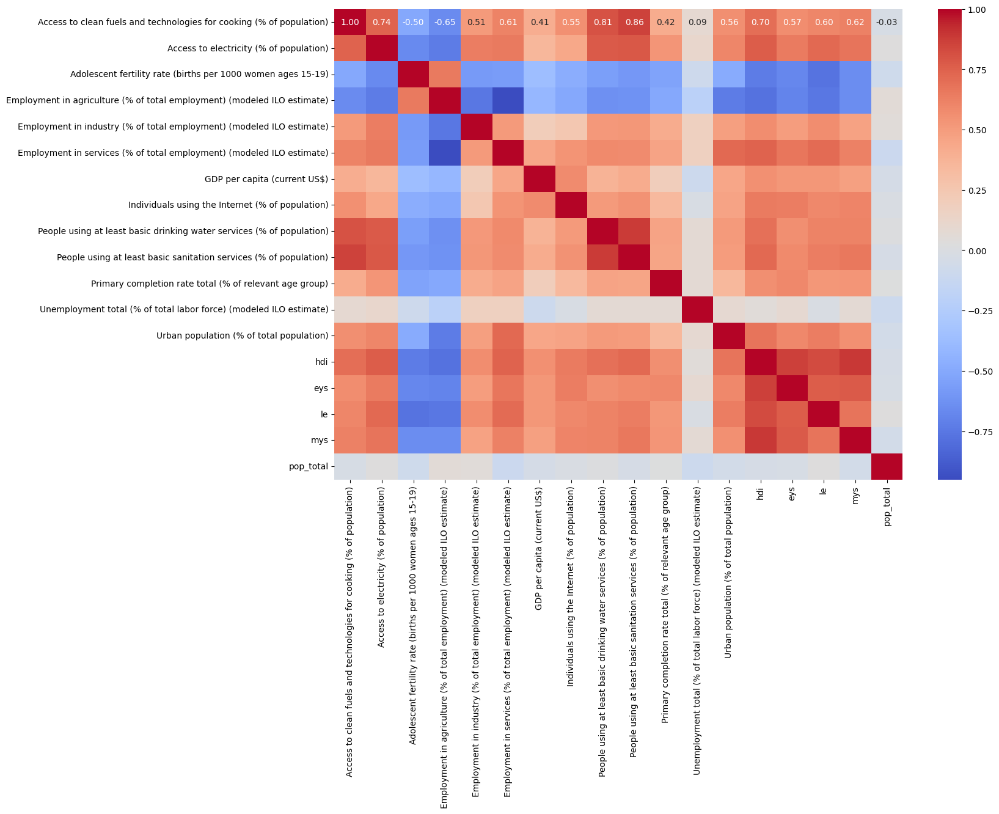

In [12]:
# Matriz de correlación
numerical_columns = df_clean.select_dtypes(include=['float64', 'int64']).columns

# Extraer solo las columnas numéricas
numerical_df = df_clean[numerical_columns]

# Calcular la matriz de correlación
correlation_matrix = numerical_df.corr()

# Heatmap de la matriz de correlación
plt.figure(figsize=(15, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.show()


c:\Users\Pablo Zamora\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Pablo Zamora\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


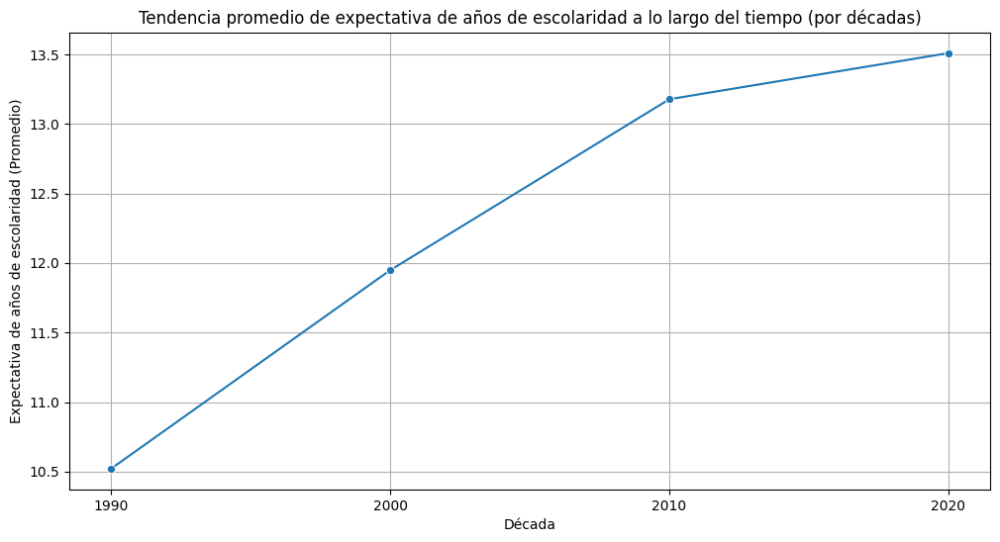

In [33]:
# Tendencia a lo largo del tiempo de la variable objetivo

# Asegurarse de que la columna 'Year' sea de tipo entero
df_clean['Year'] = df_clean['Year'].astype(int)

# Agrupar los datos por décadas
df_clean['Decade'] = (df_clean['Year'] // 10) * 10

# Calcular el promedio de 'eys' por década
decade_avg_eys = df_clean.groupby('Decade')['eys'].mean().reset_index()

# Gráfica de la tendencia promedio de 'eys' por década
plt.figure(figsize=(12, 6))  # Tamaño de la figura ajustado para mayor legibilidad
sns.lineplot(x='Decade', y='eys', data=decade_avg_eys, marker='o')
plt.title('Tendencia promedio de expectativa de años de escolaridad a lo largo del tiempo (por décadas)')
plt.xlabel('Década')
plt.ylabel('Expectativa de años de escolaridad (Promedio)')
plt.xticks(decade_avg_eys['Decade'])  # Mostrar todas las décadas en el eje x
plt.grid(True)
plt.show()


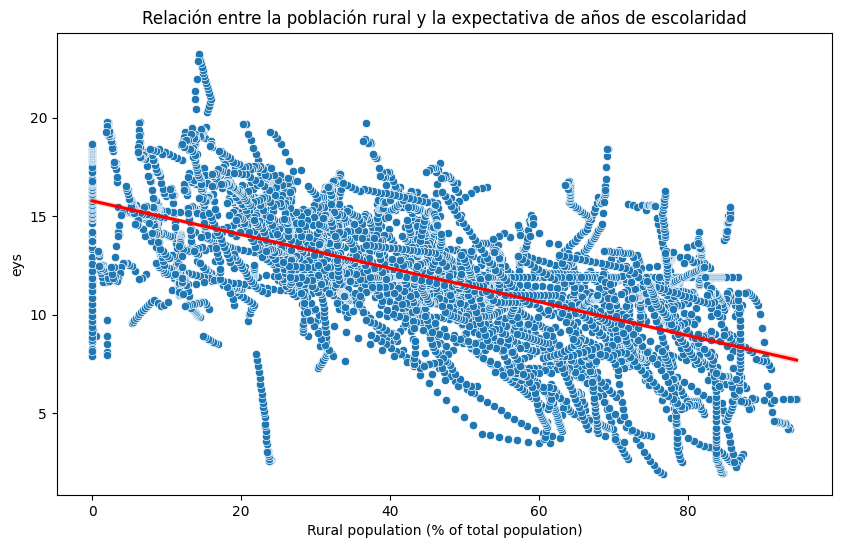

In [31]:
# Importar librerías necesarias
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Suponemos que df_clean es tu dataframe limpio
# Calcular el porcentaje de población rural
df_clean['Rural population (% of total population)'] = 100 - df_clean['Urban population (% of total population)']

# Crear el scatter plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Rural population (% of total population)', y='eys', data=df_clean)
plt.title('Relación entre la población rural y la expectativa de años de escolaridad')
plt.xlabel('Población rural (% del total)')
plt.ylabel('Expectativa de años de escolaridad (eys)')

# Agregar una línea de tendencia
sns.regplot(x='Rural population (% of total population)', y='eys', data=df_clean, scatter=False, color='red')

plt.show()

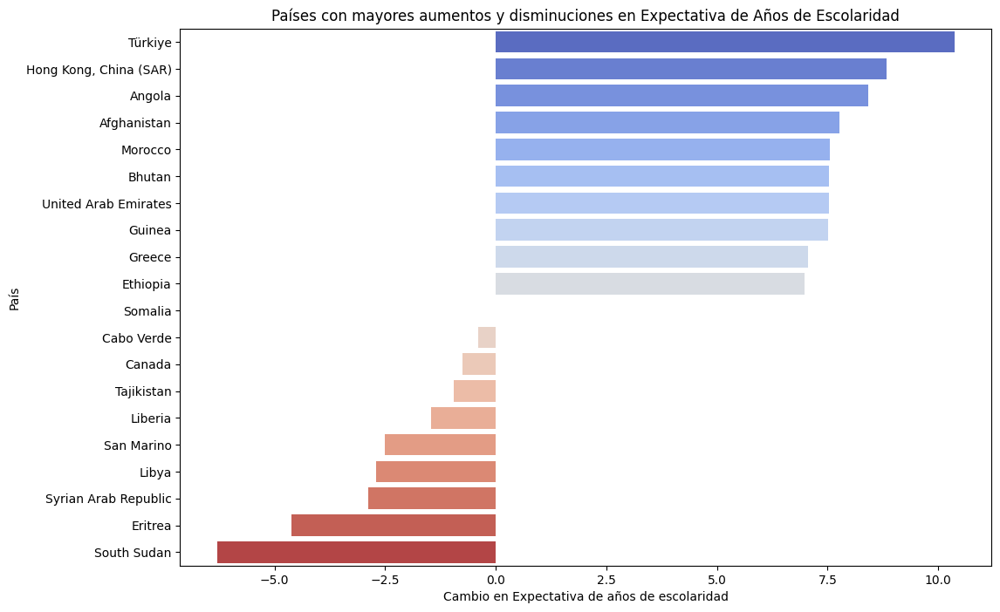

In [22]:
# Mayores diferencias en la variable objetivo por país

# Obtener el primer y último año registrado para cada país
first_last_eys = df_clean.groupby('country').agg(
    first_eys=('eys', 'first'),
    last_eys=('eys', 'last')
).reset_index()

# Calcular la diferencia
first_last_eys['change_in_eys'] = first_last_eys['last_eys'] - first_last_eys['first_eys']

# Ordenar por cambio en eys
first_last_eys_sorted = first_last_eys.sort_values(by='change_in_eys', ascending=False)

# Seleccionar los 10 países con mayores aumentos y los 10 con mayores disminuciones
top_increases = first_last_eys_sorted.head(10)
top_decreases = first_last_eys_sorted.tail(10)

# Concatenar los dos dataframes de mayores aumentos y disminuciones
top_changes = pd.concat([top_increases, top_decreases])

# Crear el gráfico de barras
plt.figure(figsize=(12, 8))
sns.barplot(x='change_in_eys', y='country', data=top_changes, palette='coolwarm')
plt.title('Países con mayores aumentos y disminuciones en Expectativa de Años de Escolaridad')
plt.xlabel('Cambio en Expectativa de años de escolaridad')
plt.ylabel('País')
plt.show()

C:\Users\Pablo Zamora\AppData\Local\Temp\ipykernel_15644\3136384163.py:2: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df_clean['eys'], shade=True)
c:\Users\Pablo Zamora\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


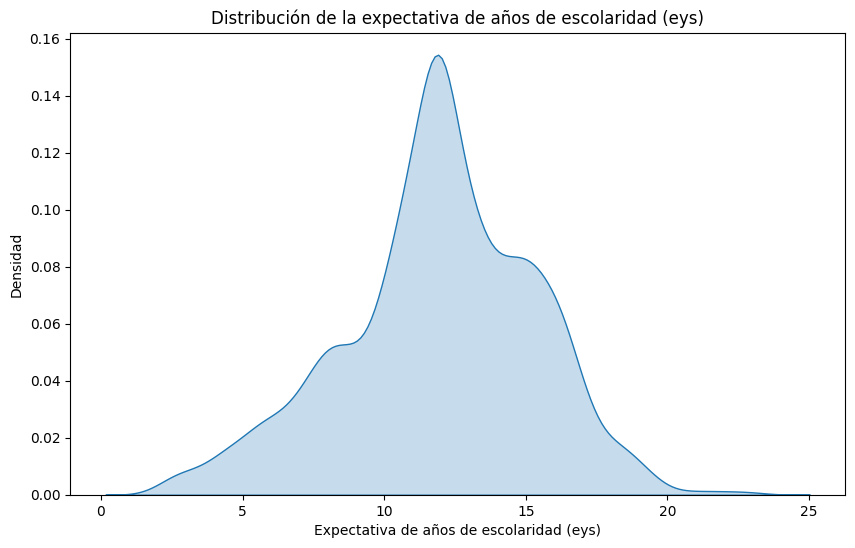

In [23]:
plt.figure(figsize=(10, 6))
sns.kdeplot(df_clean['eys'], shade=True)
plt.title('Distribución de la expectativa de años de escolaridad (eys)')
plt.xlabel('Expectativa de años de escolaridad (eys)')
plt.ylabel('Densidad')
plt.show()


C:\Users\Pablo Zamora\AppData\Local\Temp\ipykernel_15644\3505868770.py:12: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df_clean[col], shade=True)
c:\Users\Pablo Zamora\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Pablo Zamora\AppData\Local\Temp\ipykernel_15644\3505868770.py:12: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(df_clean[col], shade=True)
c:\Users\Pablo Zamora\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecat

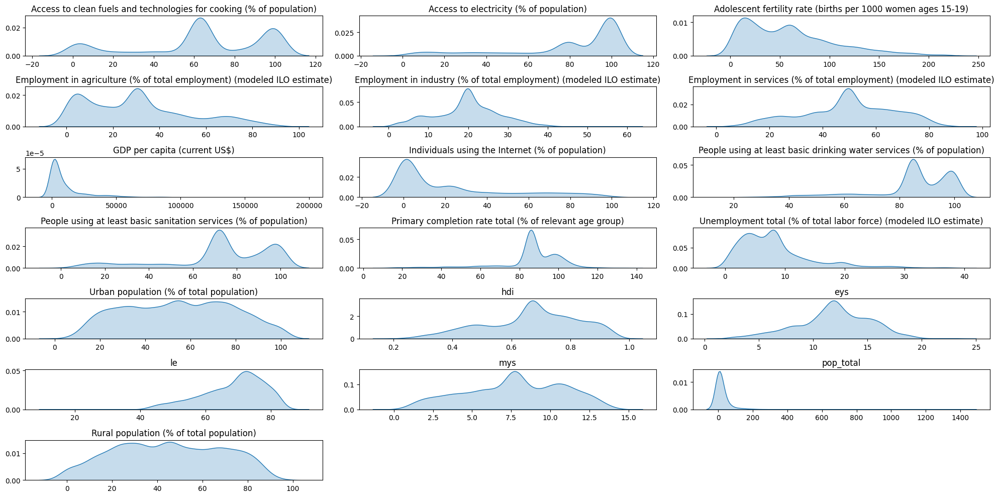

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Seleccionar las columnas numéricas
numerical_columns = df_clean.select_dtypes(include=['float64', 'int64']).columns

# Crear gráficos de densidad para cada variable numérica
plt.figure(figsize=(20, 10))
for i, col in enumerate(numerical_columns, 1):
    plt.subplot(len(numerical_columns) // 3 + 1, 3, i)  # Ajustar el número de filas y columnas según el número de variables
    sns.kdeplot(df_clean[col], shade=True)
    plt.title(col)
    plt.xlabel('')
    plt.ylabel('')

plt.tight_layout()
plt.show()
